In [1]:
# coding: utf-8
import pandas as pd
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
import QUANTAXIS as QA
import until
import time
import os 

np.set_printoptions(suppress=True)
pd.set_option('display.float_format', lambda x: '%.5f' % x) 

In [2]:
#读取数据
datapath='E:\\Desktop\\data\\'
factorpath='E:\\Desktop\\factors\\'

data_hfq=pd.read_hdf(datapath+'data_hfq.h5','data_hfq')
data_bfq=pd.read_hdf(datapath+'data_bfq.h5','data_bfq')

KeyboardInterrupt: 

In [ ]:
#对数据进行基本的处理
Open     = data_hfq["open"].unstack()
Close    = data_hfq["close"].unstack()
High     = data_hfq["high"].unstack()
Low      = data_hfq["low"].unstack()
Vol      = data_hfq["volume"].unstack()
Amount   = data_hfq["amount"].unstack()
chg_1_d  = Close.pct_change()
stock_info=QA.QA_fetch_stock_info(code=Open.columns.to_list())
sz       = data_bfq['close'].unstack().mul(stock_info["zongguben"],axis=1)
ltsz     = data_bfq['close'].unstack().mul(stock_info["liutongguben"],axis=1)
vwap     = Amount/Vol/100


#去除涨跌停，去除停牌股
tradeable=data_bfq['amount'].apply(lambda x :1 if x>0 else np.nan)*(data_bfq['high']-data_bfq['low']).apply(lambda x :1 if x!=0 else np.nan)*chg_1_d.stack().apply(lambda x :1 if x<0.100 else np.nan)
tradeable=tradeable.unstack()

#获取基准
Benchmark=QA.QA_fetch_index_day_adv('000905',tradeable.index[0],tradeable.index[-1]).close
Benchmark.index=(Benchmark.index).get_level_values(0)
Benchmark=(Benchmark.pct_change(1)).shift(-1)
megedata=pd.DataFrame()
# #megedata["period"]=Close.pct_change(1).shift(-1).stack()#以收盘价交易
megedata["period"]=Open.pct_change().shift(-2).stack()#以开盘价交易

In [6]:
#定义一个因子
def factor_simple():
    factor=-1*Close.pct_change(5)
    return factor
test_factor=factor_simple()

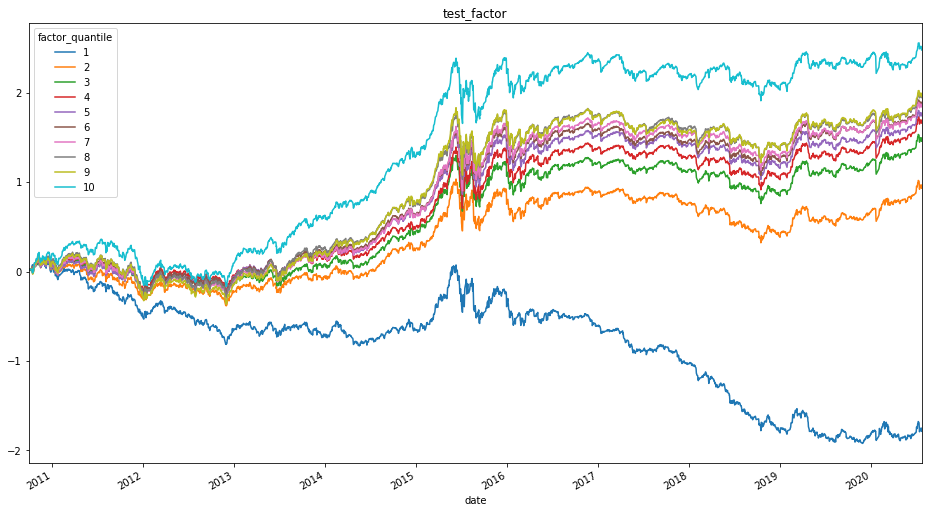

In [7]:
#分层画图
test_factor=test_factor.replace([np.inf, -np.inf], np.nan)
clean_factor_data=megedata
input_factor= test_factor*tradeable
input_factor=input_factor.stack()
clean_factor_data["factor"]=input_factor
clean_factor_data=clean_factor_data.dropna()

clean_factor_data["factor_quantile"]=clean_factor_data["factor"].groupby(level=0).apply(lambda x :((pd.qcut(x.rank(), 10, labels=False,duplicates='drop') + 1)))
df_factor_quantile=clean_factor_data.reset_index().groupby(['date','factor_quantile'])["period"].mean().unstack().cumsum()
df_factor_quantile.plot(figsize=(16,9),title="test_factor")

In [11]:
factorpath=r'E:\Users\Desktop\factorhub\factors'

for i in os.listdir(factorpath):
    test_factor=pd.read_pickle(factorpath+"\\"+i).rank(axis=1)
    test_factor=test_factor.replace([np.inf, -np.inf], np.nan)
    clean_factor_data=megedata
    input_factor= test_factor*tradeable
    input_factor=input_factor.stack()
    clean_factor_data["factor"]=input_factor
    clean_factor_data=clean_factor_data.dropna()

    clean_factor_data["factor_quantile"]=clean_factor_data["factor"].groupby(level=0).apply(lambda x :((pd.qcut(x.rank(), 10, labels=False,duplicates='drop') + 1)))
    df_factor_quantile=clean_factor_data.reset_index().groupby(['date','factor_quantile'])["period"].mean().unstack().cumsum()
    ax=df_factor_quantile.plot(figsize=(16,9),title=i[:-4])
    fig = ax.get_figure()
    fig.savefig('E:\\Users\\Desktop\\factorhub\\factor_fig\\'+i[:-4]+'A.png')


KeyboardInterrupt: 

In [ ]:
#不算复利,计算对冲收益
group_num=10
commision_fee=0.0

test_factor=test_factor.replace([np.inf, -np.inf], np.nan)
clean_factor_data=megedata
input_factor= test_factor*tradeable
input_factor=input_factor.stack()

clean_factor_data["factor"]=input_factor
clean_factor_data=clean_factor_data.dropna()
clean_factor_data["factor_quantile"]=clean_factor_data["factor"].groupby(level=0).apply(lambda x :((pd.qcut(x.rank(), 10, labels=False,duplicates='drop') + 1)))

long_portfolio_data = clean_factor_data[clean_factor_data['factor_quantile'] == group_num]
short_portfolio_data = clean_factor_data[clean_factor_data['factor_quantile'] == 1]

long_portfolio_rate_of_return = long_portfolio_data['period'].mean(level=0) - commision_fee
short_portfolio_rate_of_return = short_portfolio_data['period'].mean(level=0) - commision_fee
hedged_rate_of_return = long_portfolio_rate_of_return - short_portfolio_rate_of_return - 2 * commision_fee
hedged_with_Benchmark_return = long_portfolio_rate_of_return - Benchmark - commision_fee

long_cumulative_return = 1+long_portfolio_rate_of_return.cumsum()
short_cumulative_return = 1+short_portfolio_rate_of_return.cumsum()
hedged_cumulative_return = 1+hedged_rate_of_return.cumsum()
Benchmark_cumulative_return = 1+Benchmark.cumsum()
hedged_with_Benchmark_cumulative_return = 1+hedged_with_Benchmark_return.cumsum()

Return = pd.concat([long_cumulative_return,short_cumulative_return, hedged_cumulative_return, Benchmark_cumulative_return,hedged_with_Benchmark_cumulative_return], axis=1)
Return.columns = ['long','short','long-short','benchmark','long-benchmark']

Return=Return.dropna()
Return.plot(figsize=(16,9),title="test—factor")


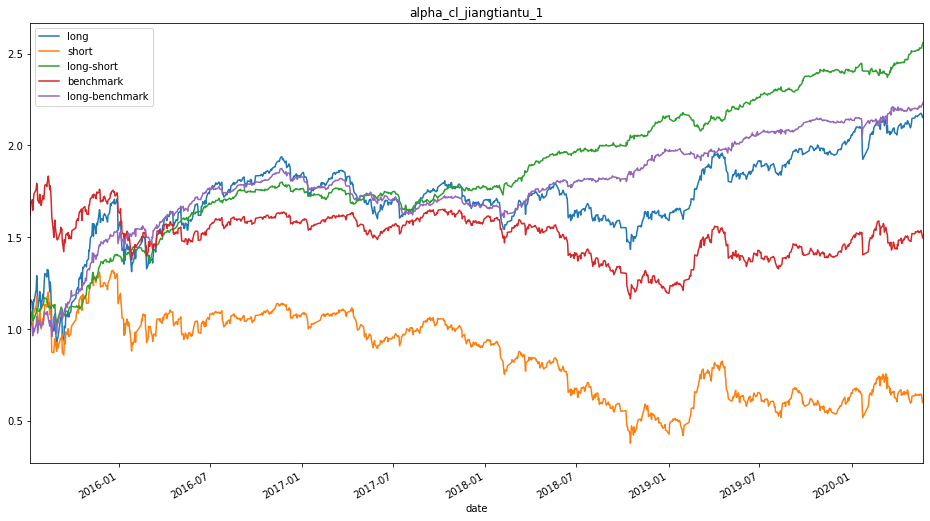

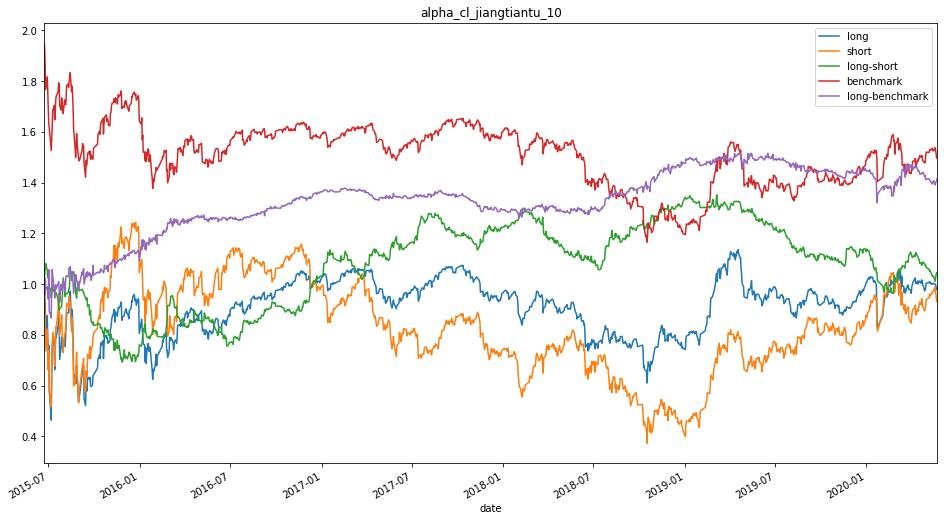

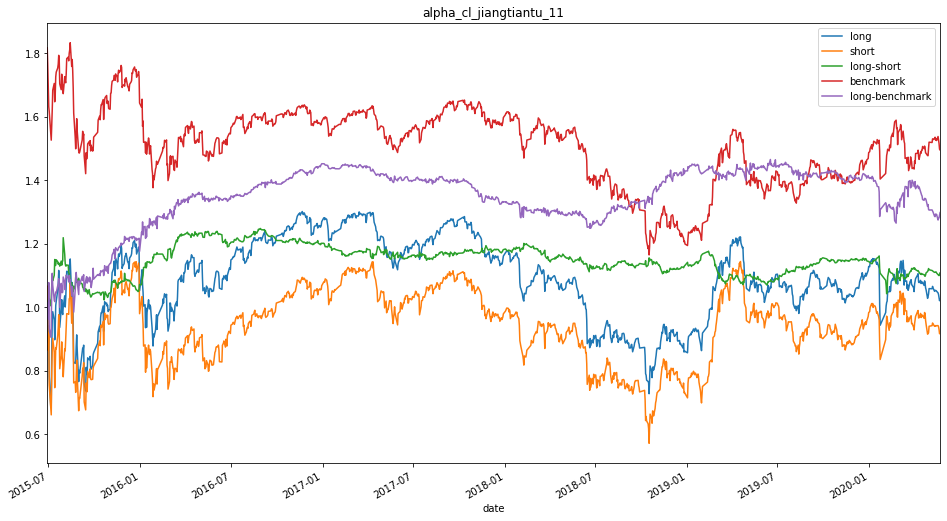

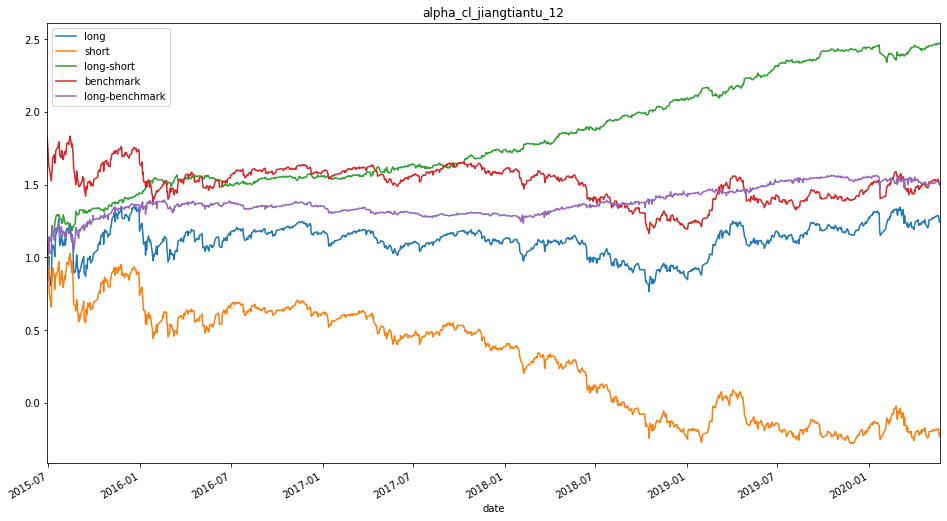

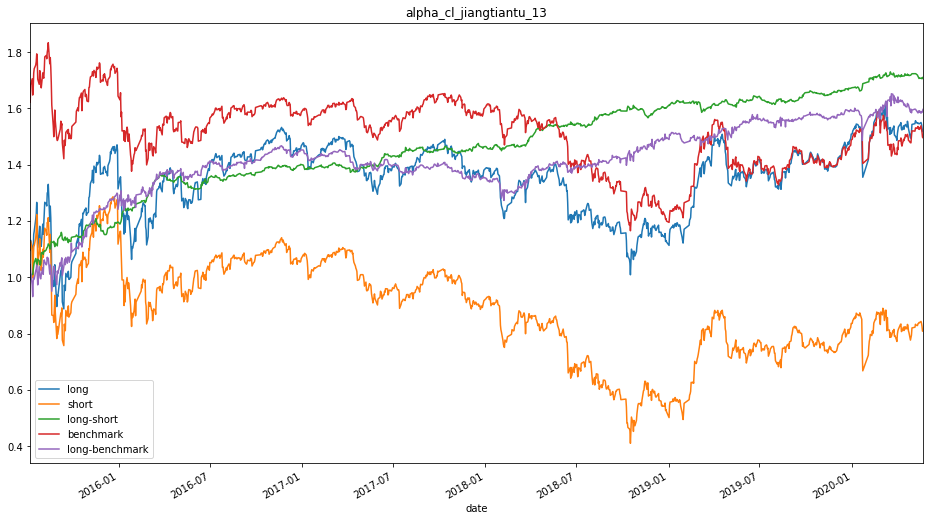

...

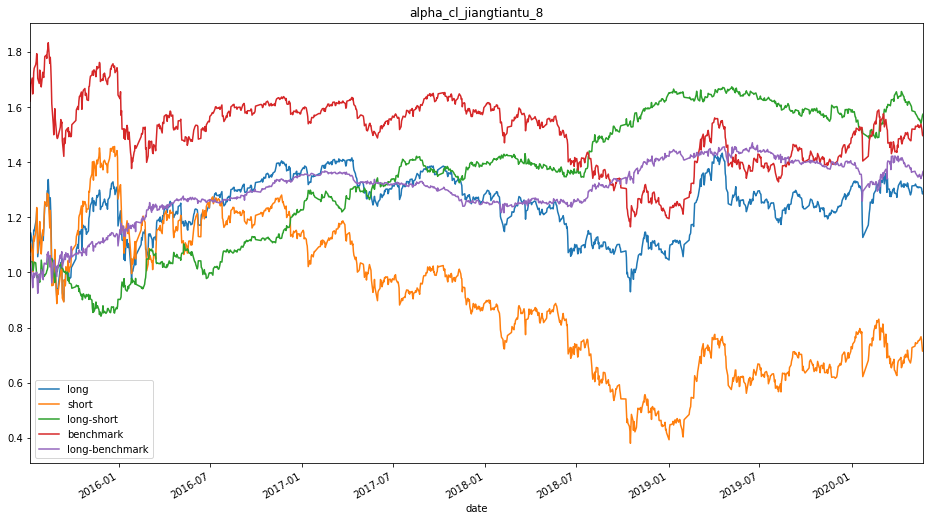

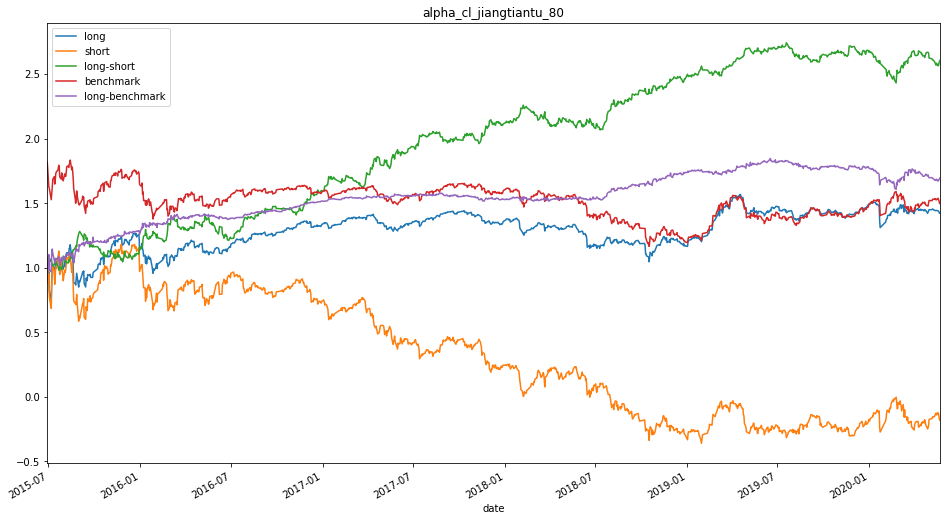

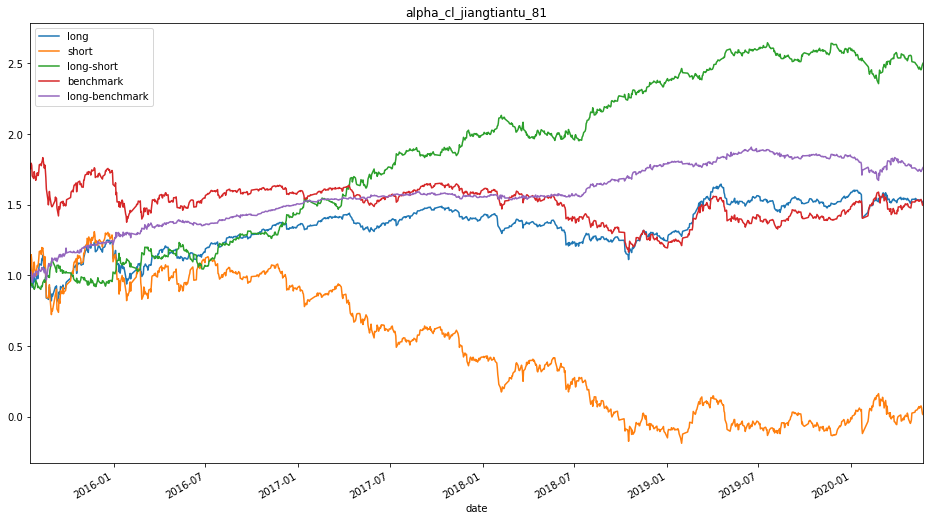

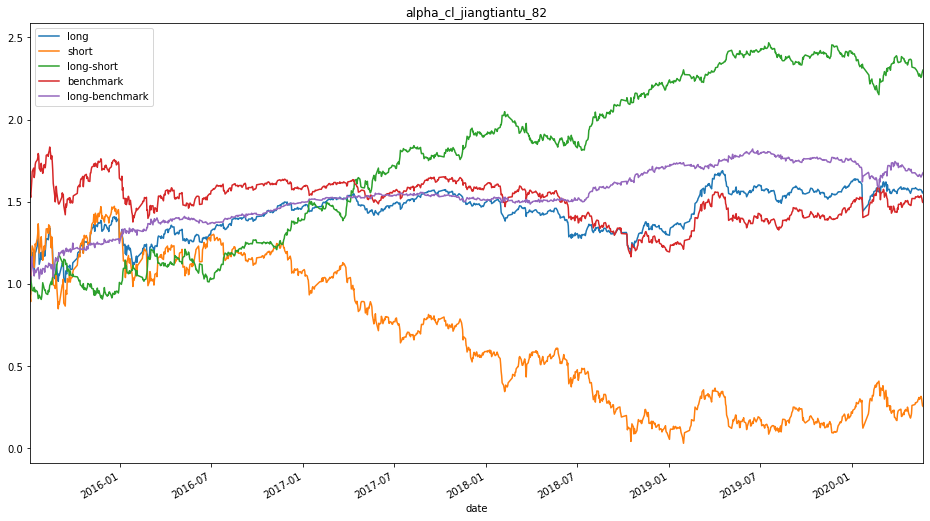

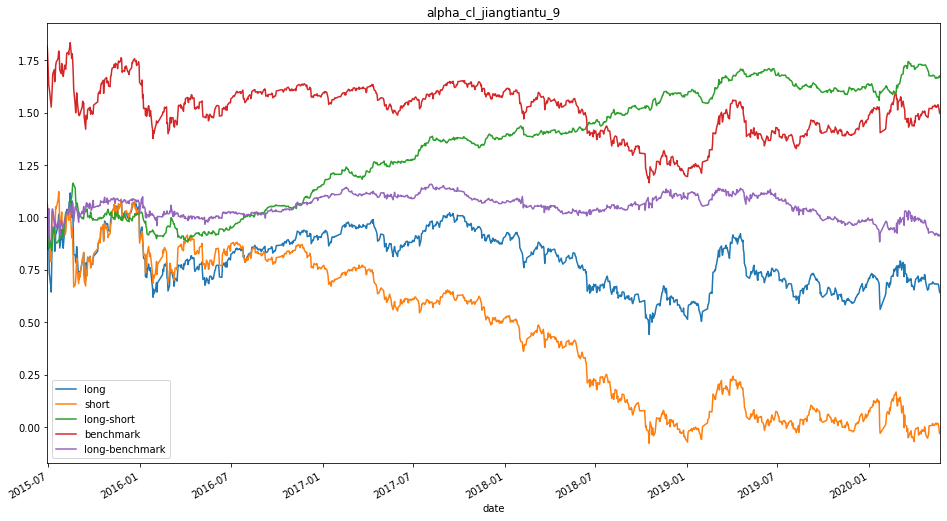

In [5]:
factorpath=r'E:\Users\Desktop\factorhub\factors'
for i in os.listdir(factorpath):
    print(i)
    group_num=10
    commision_fee=0.0
    test_factor=pd.read_pickle(factorpath+"\\"+i).rank(axis=1)
    test_factor=test_factor.replace([np.inf, -np.inf], np.nan)
    clean_factor_data=megedata
    input_factor= test_factor*tradeable
    input_factor=input_factor.stack()

    clean_factor_data["factor"]=input_factor
    clean_factor_data=clean_factor_data.dropna()
    clean_factor_data["factor_quantile"]=clean_factor_data["factor"].groupby(level=0).apply(lambda x :((pd.qcut(x.rank(), 10, labels=False,duplicates='drop') + 1)))

    long_portfolio_data = clean_factor_data[clean_factor_data['factor_quantile'] == group_num]
    short_portfolio_data = clean_factor_data[clean_factor_data['factor_quantile'] == 1]

    long_portfolio_rate_of_return = long_portfolio_data['period'].mean(level=0) - commision_fee
    short_portfolio_rate_of_return = short_portfolio_data['period'].mean(level=0) - commision_fee
    hedged_rate_of_return = long_portfolio_rate_of_return - short_portfolio_rate_of_return - 2 * commision_fee
    hedged_with_Benchmark_return = long_portfolio_rate_of_return - Benchmark - commision_fee

    long_cumulative_return = 1+long_portfolio_rate_of_return.cumsum()
    short_cumulative_return = 1+short_portfolio_rate_of_return.cumsum()
    hedged_cumulative_return = 1+hedged_rate_of_return.cumsum()
    Benchmark_cumulative_return = 1+Benchmark.cumsum()
    hedged_with_Benchmark_cumulative_return = 1+hedged_with_Benchmark_return.cumsum()

    Return = pd.concat([long_cumulative_return,short_cumulative_return, hedged_cumulative_return, Benchmark_cumulative_return,hedged_with_Benchmark_cumulative_return], axis=1)
    Return.columns = ['long','short','long-short','benchmark','long-benchmark']

    Return=Return.dropna()
    ax=Return.plot(figsize=(16,9),title=i[:-4])
    fig = ax.get_figure()
    fig.savefig('E:\\Users\\Desktop\\factorhub\\factor_fig\\'+i[:-4]+'B.png')